C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\2557582305.py:45: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522039.m4a (sr=44100) ===


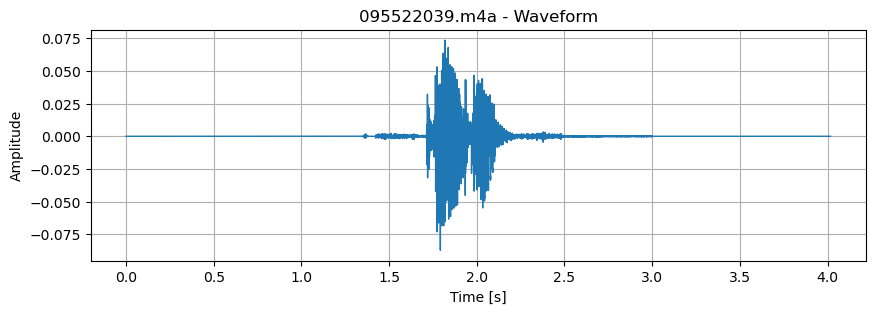

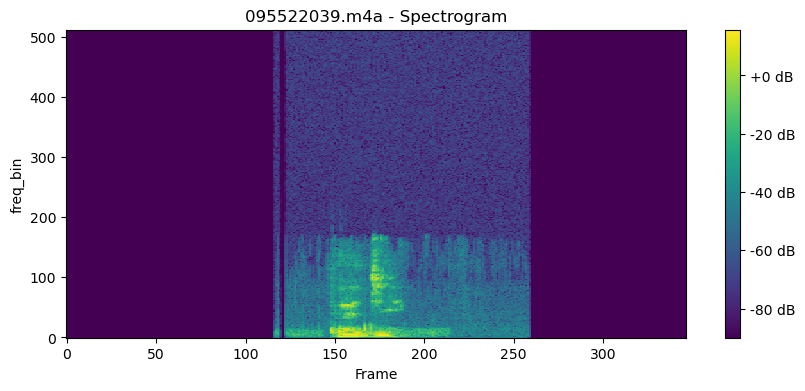

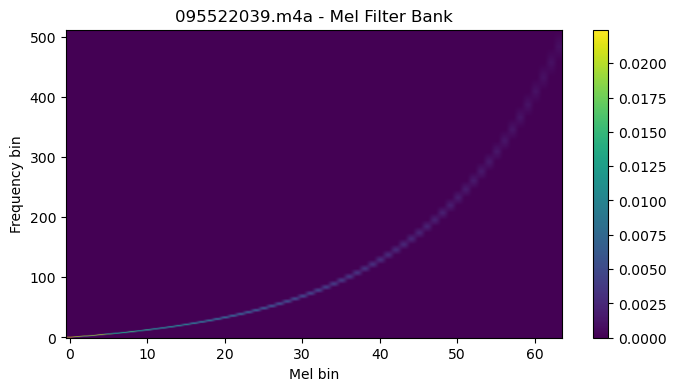

c:\Users\user\anaconda3\Lib\site-packages\torchaudio\functional\functional.py:585: UserWarning: At least one mel filterbank has all zero values. The value for `n_mels` (128) may be set too high. Or, the value for `n_freqs` (513) may be set too low.
  warnings.warn(


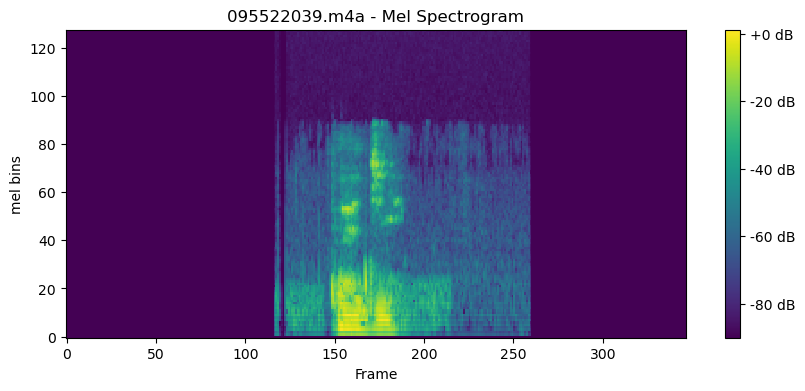

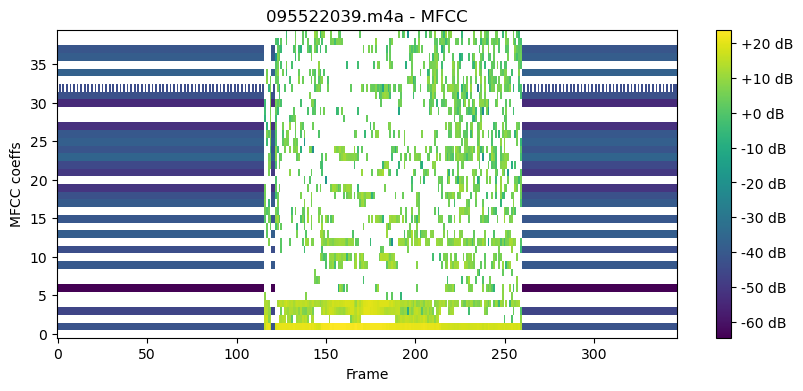

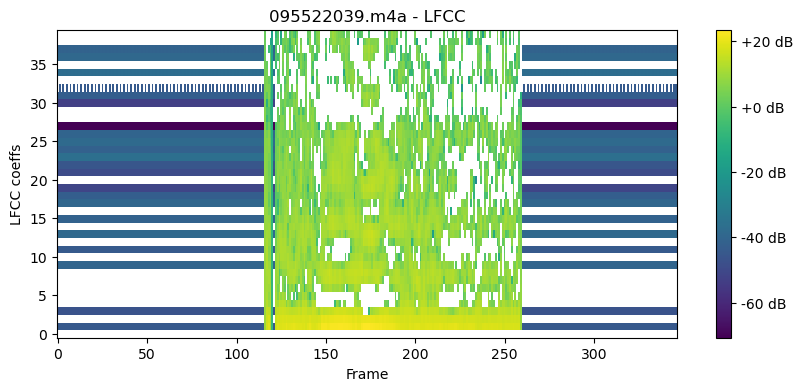

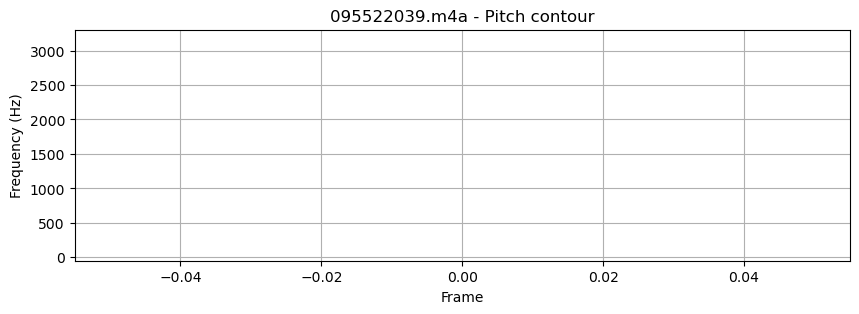


=== 095522040.m4a (sr=44100) ===


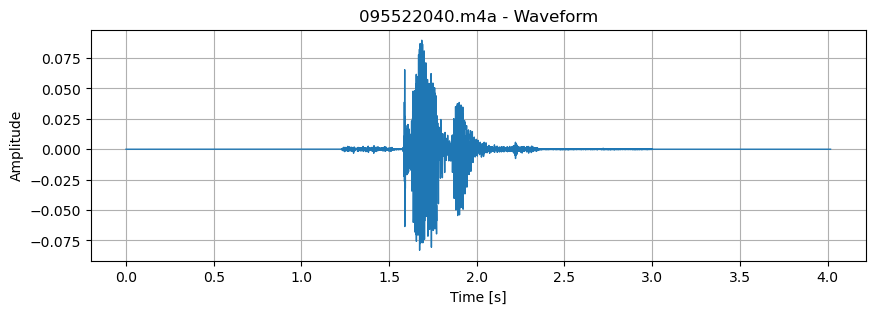

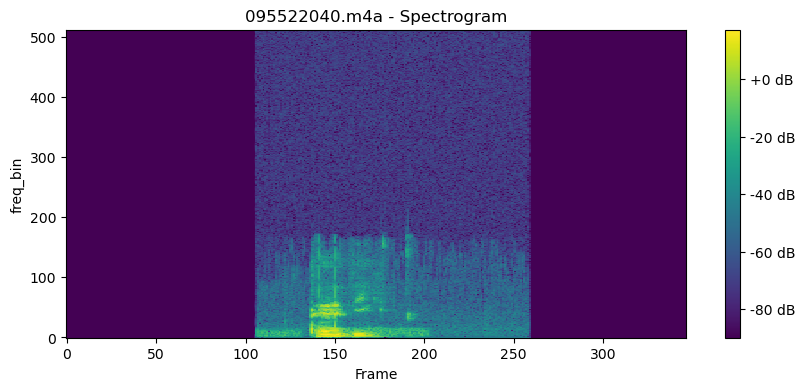

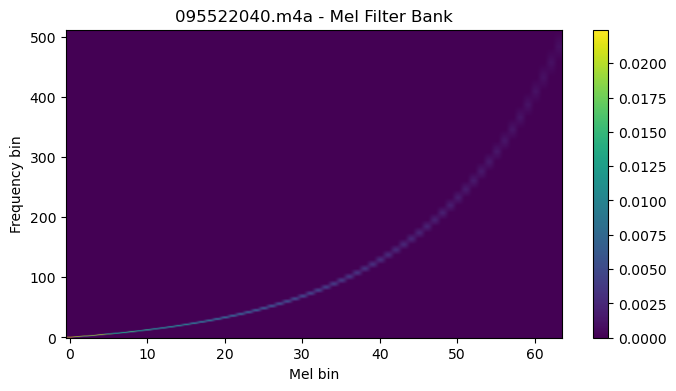

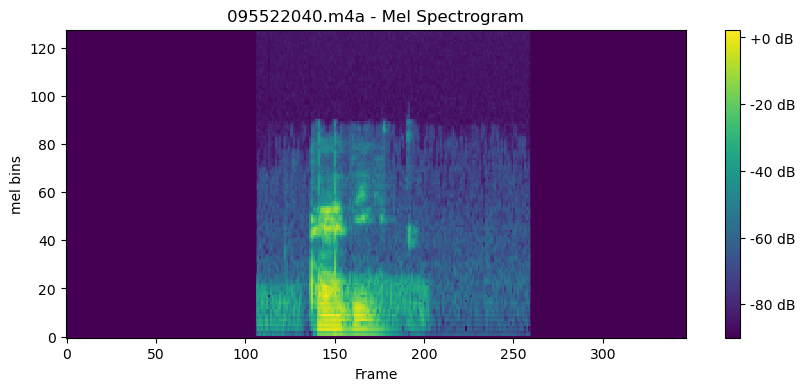

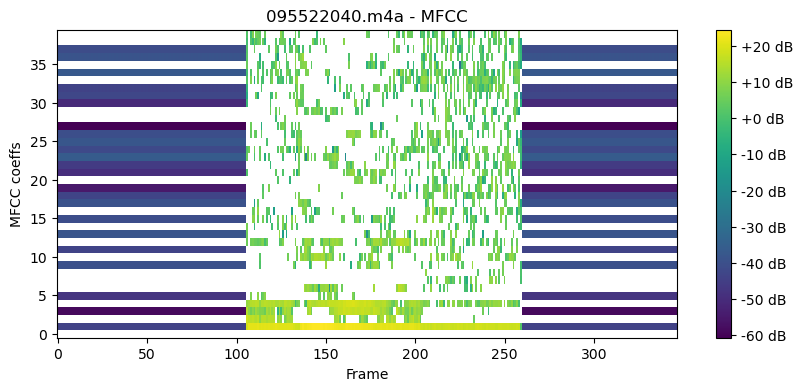

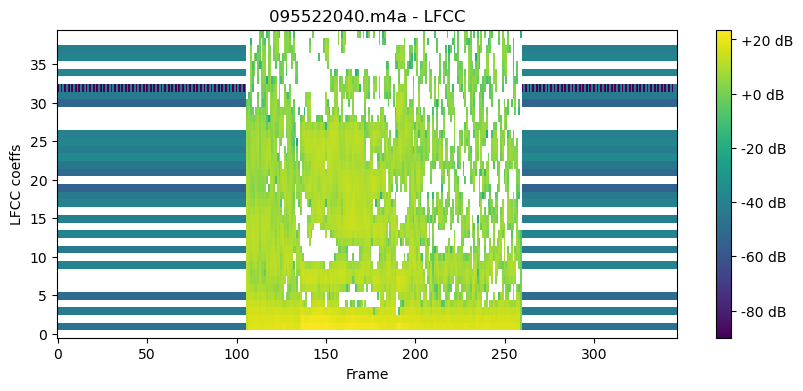

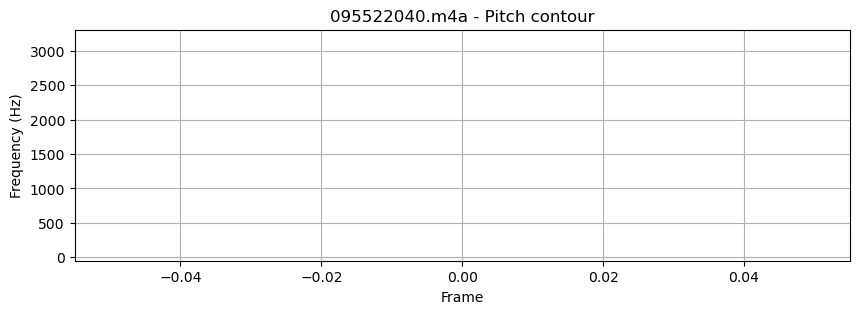


=== 095522041.m4a (sr=44100) ===


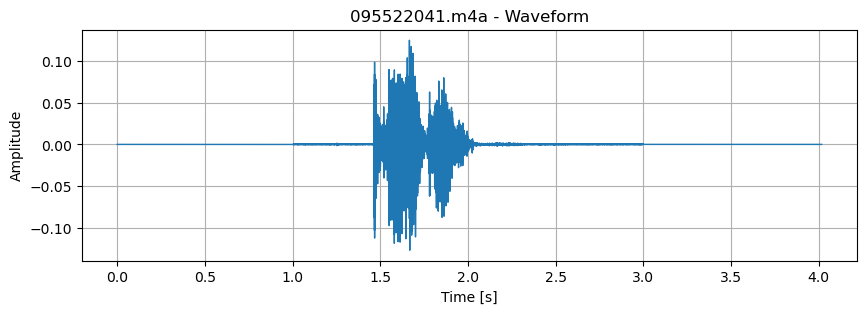

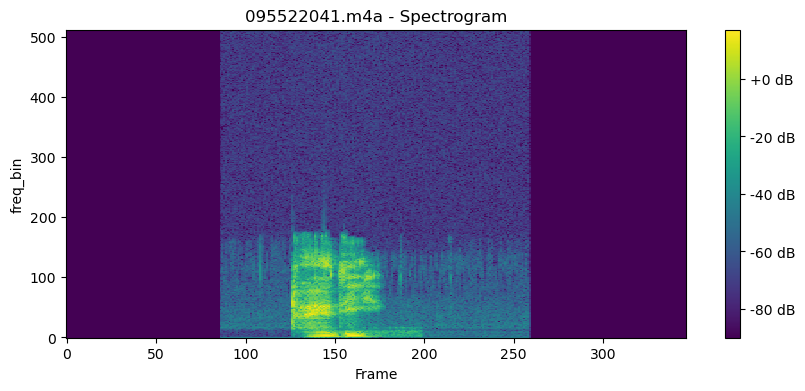

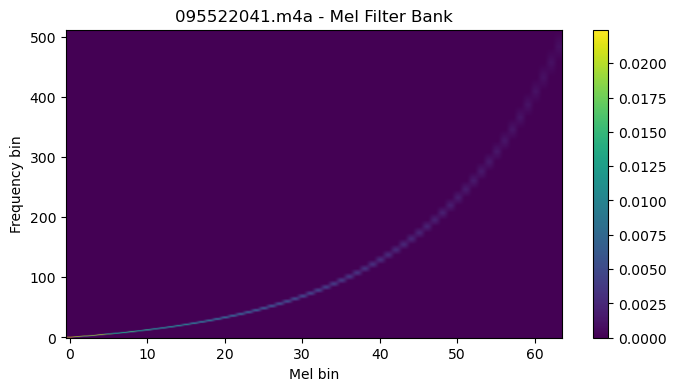

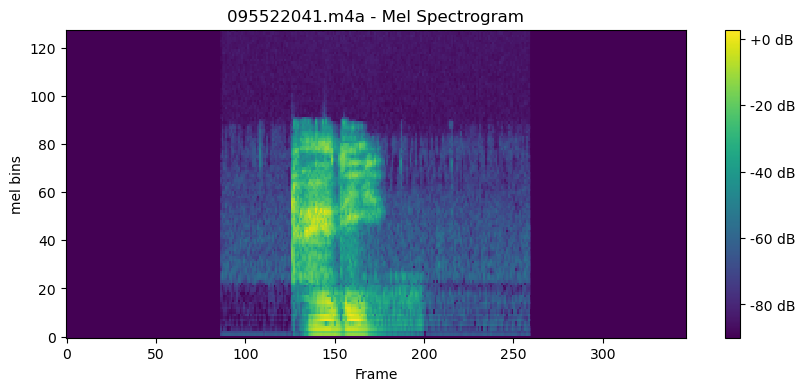

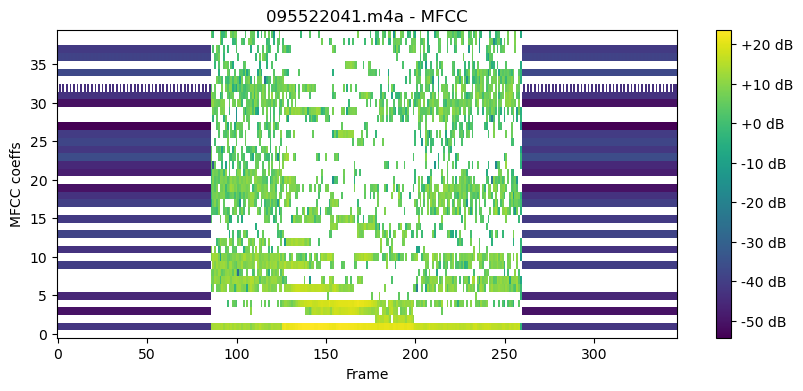

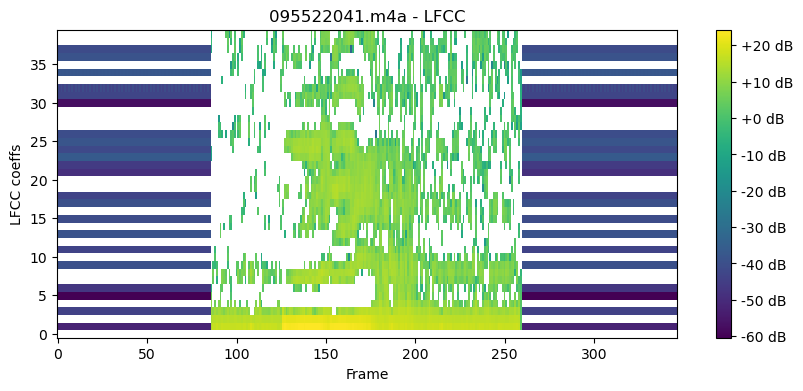

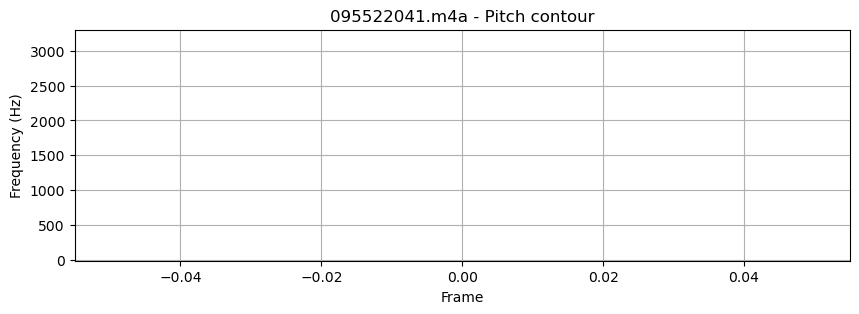


=== 095522042.m4a (sr=44100) ===


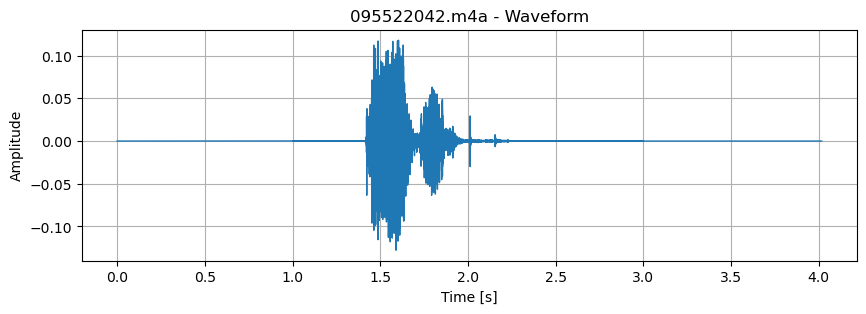

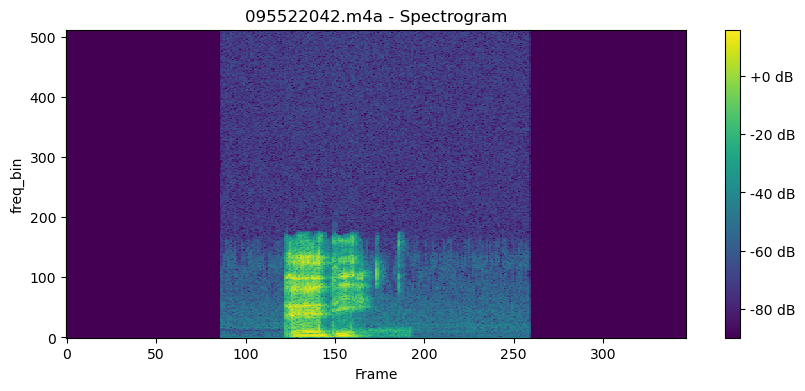

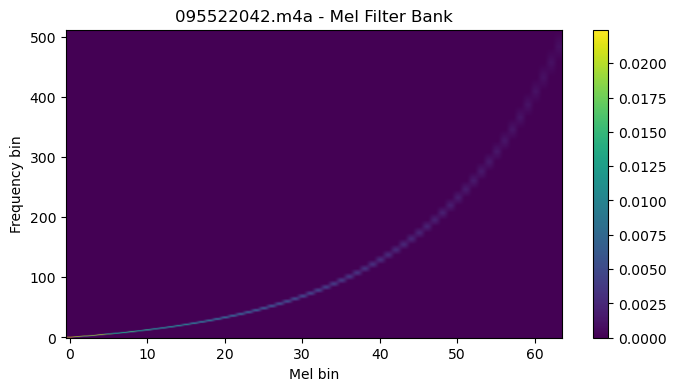

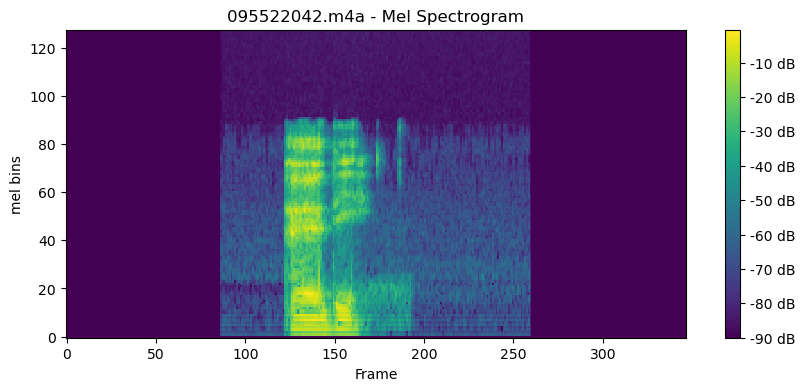

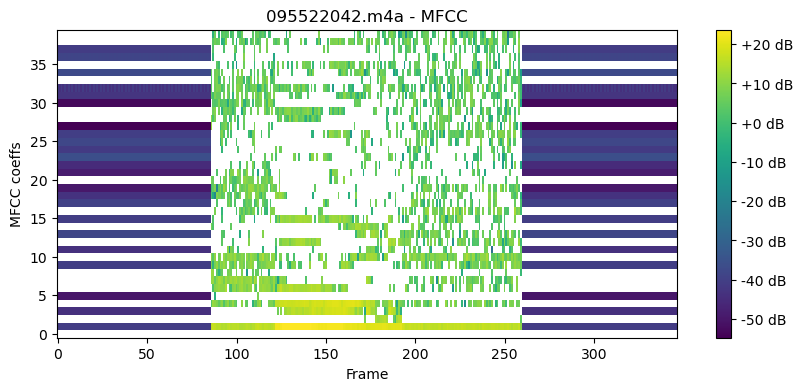

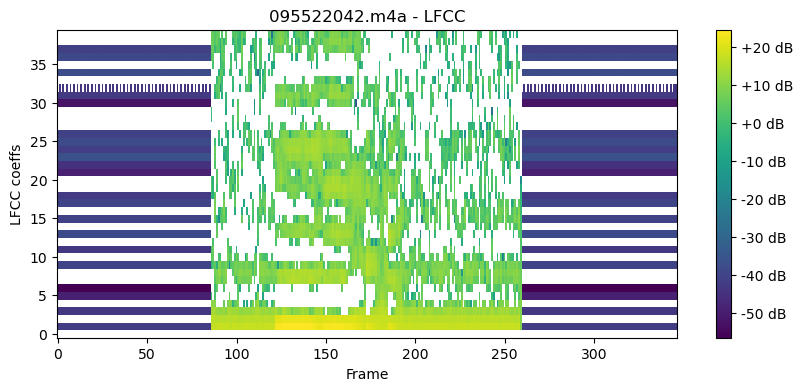

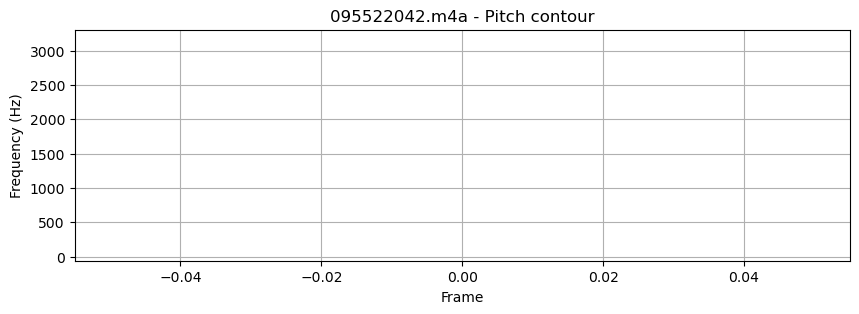

In [23]:
# Assignment 2 Reference: https://docs.pytorch.org/audio/stable/tutorials/audio_resampling_tutorial.html 
import torch, librosa
import torchaudio.transforms as T
import torchaudio.functional as F
import matplotlib.pyplot as plt
from IPython.display import Audio


def plot_waveform(waveform, sr, title="Waveform"):
    t = torch.arange(waveform.shape[-1]) / sr
    plt.figure(figsize=(10,3))
    plt.plot(t, waveform[0].numpy(), linewidth=1)
    plt.title(title)
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.show()

def plot_spectrogram(spec, title="Spectrogram", ylabel="freq_bin"):
    plt.figure(figsize=(10,4))
    plt.imshow(10*torch.log10(spec+1e-9).numpy(),
               origin="lower", aspect="auto", interpolation="nearest")
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel("Frame")
    plt.colorbar(format="%+2.0f dB")
    plt.show()

def plot_fbank(fbank, title=None):
    plt.figure(figsize=(8,4))
    plt.imshow(fbank, aspect="auto", origin="lower")
    plt.title(title or "Mel Filter Bank")
    plt.ylabel("Frequency bin")
    plt.xlabel("Mel bin")
    plt.colorbar()
    plt.show()


DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  # 039 ~ 042


for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    print(f"\n=== {f} (sr={sample_rate}) ===")

    # 1) Waveform
    plot_waveform(waveform, sample_rate, title=f"{f} - Waveform")
    display(Audio(waveform.numpy()[0], rate=sample_rate))

    # 2) Spectrogram
    spec = T.Spectrogram(n_fft=1024)(waveform)
    plot_spectrogram(spec[0], title=f"{f} - Spectrogram")

    # 3) Mel Filter Bank
    mel_filters = F.melscale_fbanks(
        n_freqs=spec.shape[1],
        n_mels=64,
        f_min=0.,
        f_max=sample_rate/2,
        sample_rate=sample_rate,
        norm="slaney",
    )
    plot_fbank(mel_filters, title=f"{f} - Mel Filter Bank")

    # 4) Mel Spectrogram
    mel_spec = T.MelSpectrogram(
        sample_rate=sample_rate,
        n_fft=1024,
        hop_length=512,
        n_mels=128,
        norm="slaney",
        mel_scale="htk"
    )(waveform)
    plot_spectrogram(mel_spec[0], title=f"{f} - Mel Spectrogram", ylabel="mel bins")

    # 5) MFCC
    mfcc = T.MFCC(
        sample_rate=sample_rate,
        n_mfcc=40,
        melkwargs={"n_fft": 1024, "n_mels": 128, "hop_length": 512, "mel_scale": "htk"},
    )(waveform)
    plot_spectrogram(mfcc[0], title=f"{f} - MFCC", ylabel="MFCC coeffs")

    # 6) LFCC
    lfcc = T.LFCC(
        sample_rate=sample_rate,
        n_lfcc=40,
        speckwargs={"n_fft": 1024, "hop_length": 512},
    )(waveform)
    plot_spectrogram(lfcc[0], title=f"{f} - LFCC", ylabel="LFCC coeffs")

    # 7) Pitch
    pitch = F.detect_pitch_frequency(waveform, sample_rate)
    plt.figure(figsize=(10,3))
    plt.plot(pitch.numpy())
    plt.title(f"{f} - Pitch contour")
    plt.xlabel("Frame")
    plt.ylabel("Frequency (Hz)")
    plt.grid(True)
    plt.show()


In [ ]:
import torch
import torchaudio
import torchaudio.functional as F
import torchaudio.transforms as T

print(torch.__version__)
print(torchaudio.__version__)


In [3]:
import math
import timeit

import librosa
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import pandas as pd
import resampy
from IPython.display import Audio

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

DEFAULT_OFFSET = 201


def _get_log_freq(sample_rate, max_sweep_rate, offset):
    """Get freqs evenly spaced out in log-scale, between [0, max_sweep_rate // 2]

    offset is used to avoid negative infinity `log(offset + x)`.

    """
    start, stop = math.log(offset), math.log(offset + max_sweep_rate // 2)
    return torch.exp(torch.linspace(start, stop, sample_rate, dtype=torch.double)) - offset


def _get_inverse_log_freq(freq, sample_rate, offset):
    """Find the time where the given frequency is given by _get_log_freq"""
    half = sample_rate // 2
    return sample_rate * (math.log(1 + freq / offset) / math.log(1 + half / offset))


def _get_freq_ticks(sample_rate, offset, f_max):
    # Given the original sample rate used for generating the sweep,
    # find the x-axis value where the log-scale major frequency values fall in
    times, freq = [], []
    for exp in range(2, 5):
        for v in range(1, 10):
            f = v * 10**exp
            if f < sample_rate // 2:
                t = _get_inverse_log_freq(f, sample_rate, offset) / sample_rate
                times.append(t)
                freq.append(f)
    t_max = _get_inverse_log_freq(f_max, sample_rate, offset) / sample_rate
    times.append(t_max)
    freq.append(f_max)
    return times, freq


def get_sine_sweep(sample_rate, offset=DEFAULT_OFFSET):
    max_sweep_rate = sample_rate
    freq = _get_log_freq(sample_rate, max_sweep_rate, offset)
    delta = 2 * math.pi * freq / sample_rate
    cummulative = torch.cumsum(delta, dim=0)
    signal = torch.sin(cummulative).unsqueeze(dim=0)
    return signal


def plot_sweep(
    waveform,
    sample_rate,
    title,
    max_sweep_rate=48000,
    offset=DEFAULT_OFFSET,
):
    x_ticks = [100, 500, 1000, 5000, 10000, 20000, max_sweep_rate // 2]
    y_ticks = [1000, 5000, 10000, 20000, sample_rate // 2]

    time, freq = _get_freq_ticks(max_sweep_rate, offset, sample_rate // 2)
    freq_x = [f if f in x_ticks and f <= max_sweep_rate // 2 else None for f in freq]
    freq_y = [f for f in freq if f in y_ticks and 1000 <= f <= sample_rate // 2]

    figure, axis = plt.subplots(1, 1)
    _, _, _, cax = axis.specgram(waveform[0].numpy(), Fs=sample_rate)
    plt.xticks(time, freq_x)
    plt.yticks(freq_y, freq_y)
    axis.set_xlabel("Original Signal Frequency (Hz, log scale)")
    axis.set_ylabel("Waveform Frequency (Hz)")
    axis.xaxis.grid(True, alpha=0.67)
    axis.yaxis.grid(True, alpha=0.67)
    figure.suptitle(f"{title} (sample rate: {sample_rate} Hz)")
    plt.colorbar(cax)

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\3860804057.py:32: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
c:\Users\user\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)



=== 095522039.m4a (sr=44100) ===


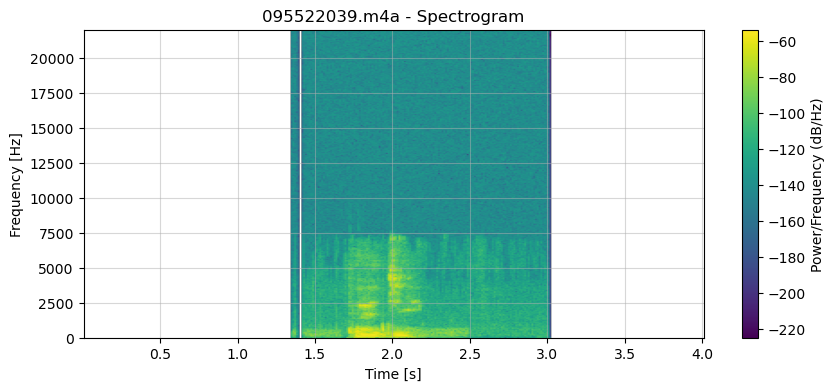


=== 095522040.m4a (sr=44100) ===


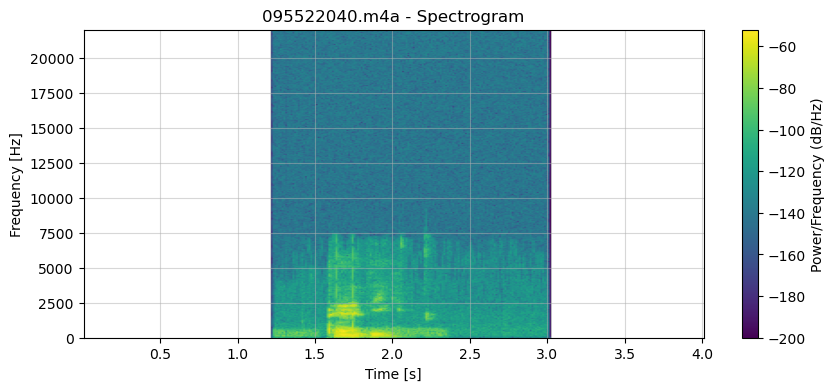


=== 095522041.m4a (sr=44100) ===


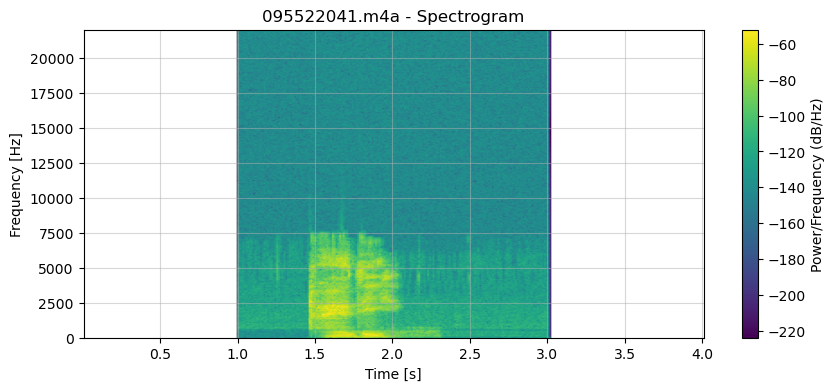


=== 095522042.m4a (sr=44100) ===


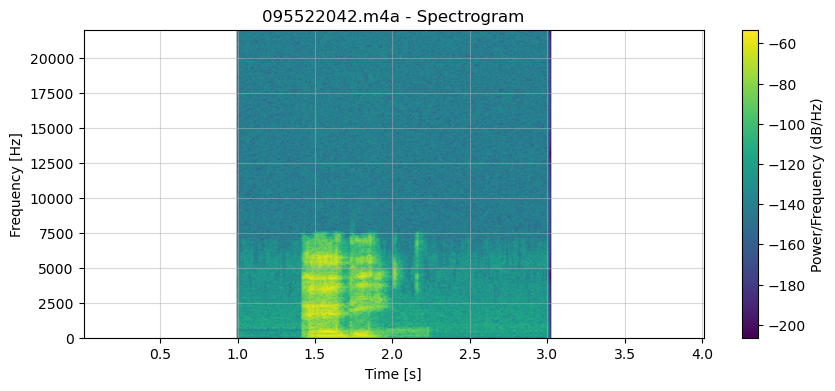

In [5]:
import torch, librosa
import matplotlib.pyplot as plt
from IPython.display import Audio

# Define helper function for real audio spectrogram
def plot_sweep_real(waveform, sample_rate, title="Spectrogram (Real Audio)"):
    """Plot spectrogram for real audio (time vs frequency)."""
    plt.figure(figsize=(10, 4))
    plt.specgram(
        waveform[0].numpy(),
        Fs=sample_rate,
        NFFT=1024,
        noverlap=512,
        scale_by_freq=True,
        mode="psd",
        detrend="constant",  # avoid ValueError: False is not allowed
    )
    plt.title(title)
    plt.xlabel("Time [s]")
    plt.ylabel("Frequency [Hz]")
    plt.colorbar(label="Power/Frequency (dB/Hz)")
    plt.grid(True, alpha=0.5)
    plt.show()

# ---- Run on 4 audio files ----
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  # 039 ~ 042

for f in FILES:
    path = fr"{DATA}\{f}"
    # Load audio file (keep original sample rate)
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    print(f"\n=== {f} (sr={sample_rate}) ===")
    # Plot real audio spectrogram
    plot_sweep_real(waveform, sample_rate, title=f"{f} - Spectrogram")
    # Play audio
    display(Audio(waveform.numpy()[0], rate=sample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\3075092817.py:8: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


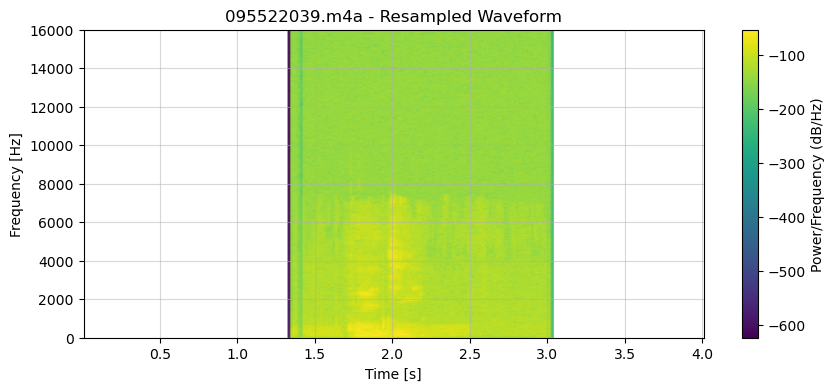


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


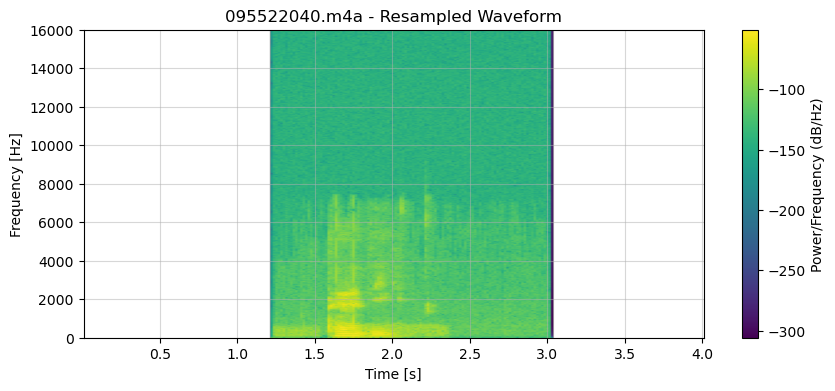


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


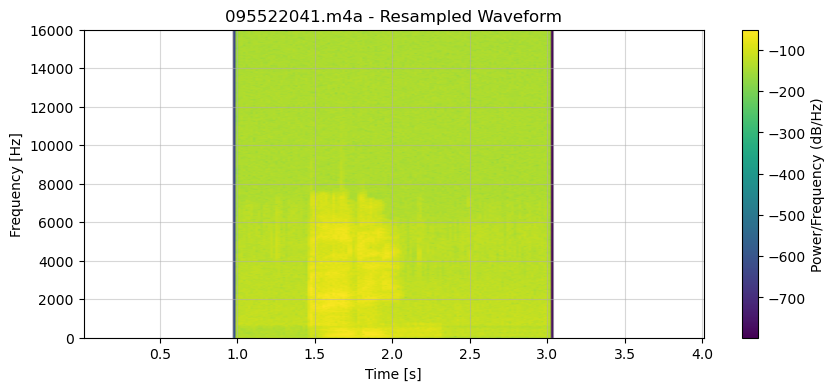


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


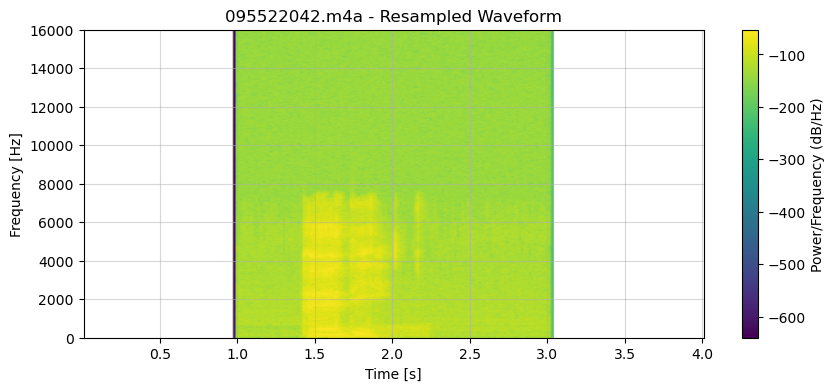

In [6]:
import torchaudio.transforms as T
import torchaudio.functional as F

resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample using torchaudio
    resampler = T.Resample(sample_rate, resample_rate, dtype=waveform.dtype)
    resampled_waveform = resampler(waveform)

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram for resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Resampled Waveform")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\381262485.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


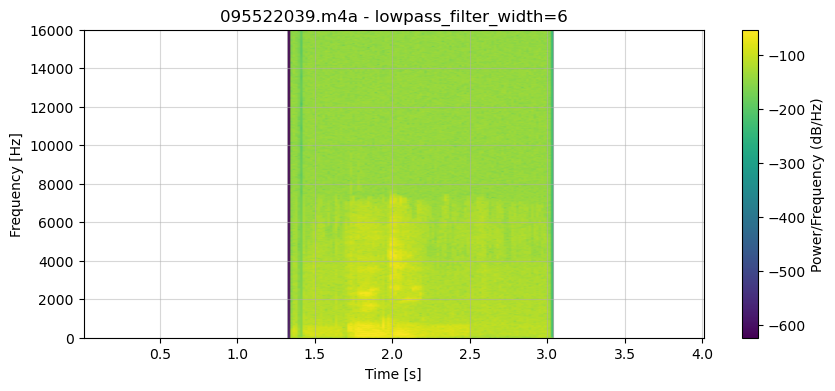


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


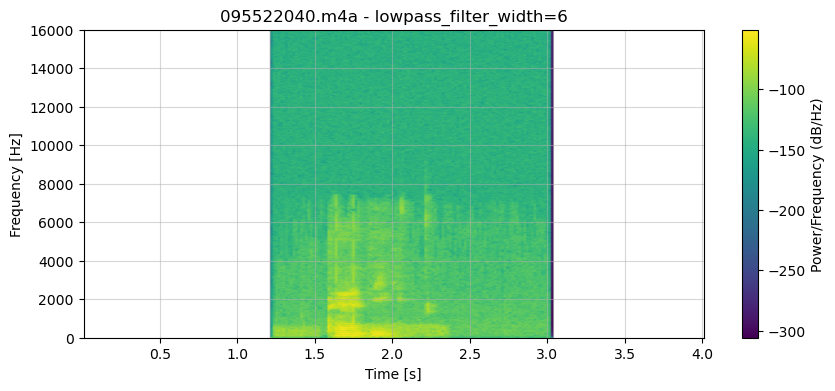


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


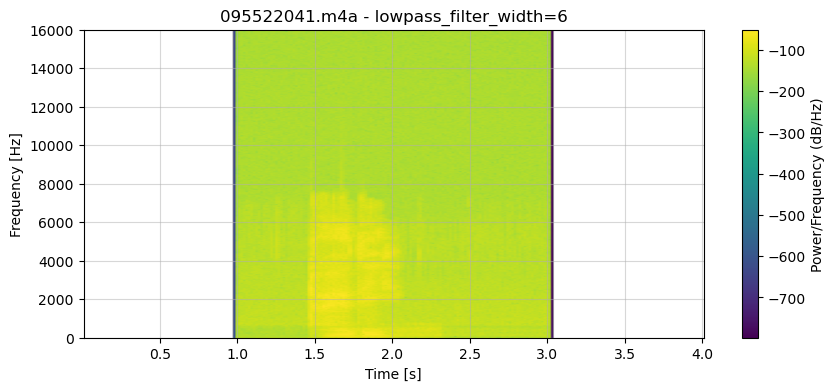


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


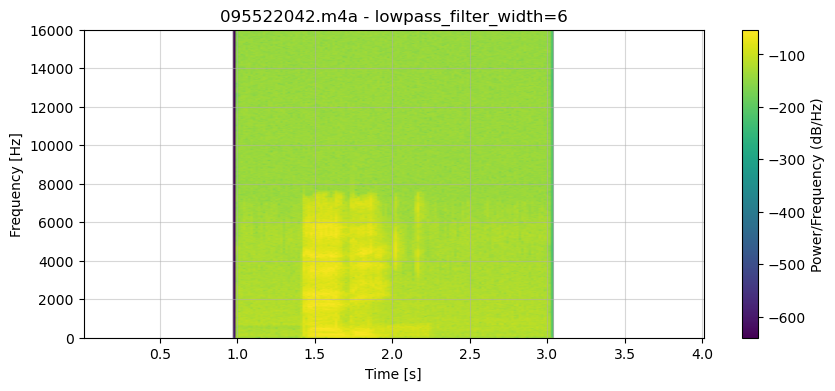

In [7]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with lowpass_filter_width=6
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, lowpass_filter_width=6
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - lowpass_filter_width=6")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\1135425483.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


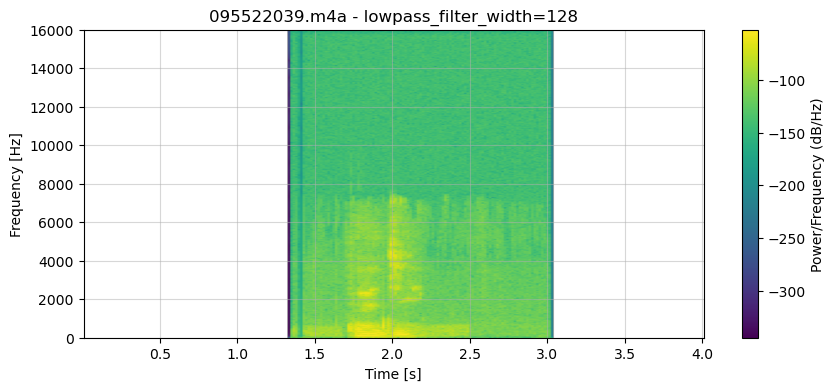


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


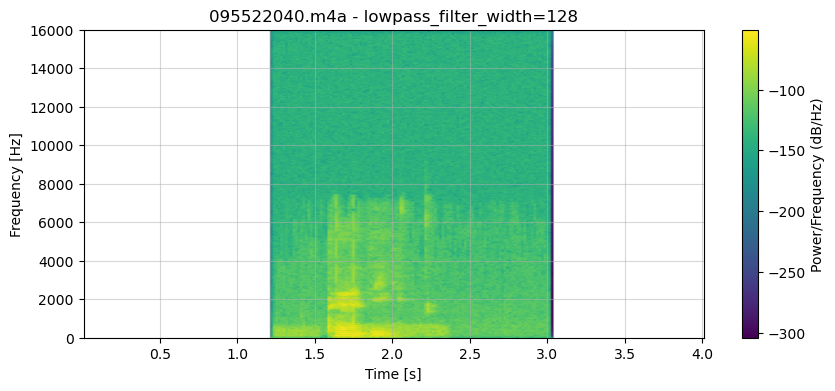


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


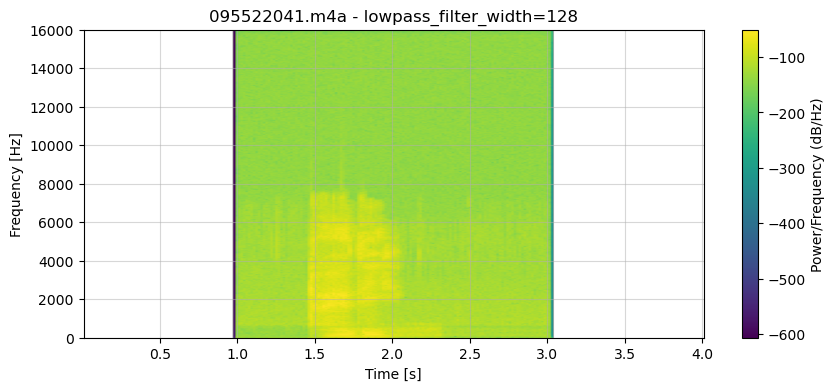


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


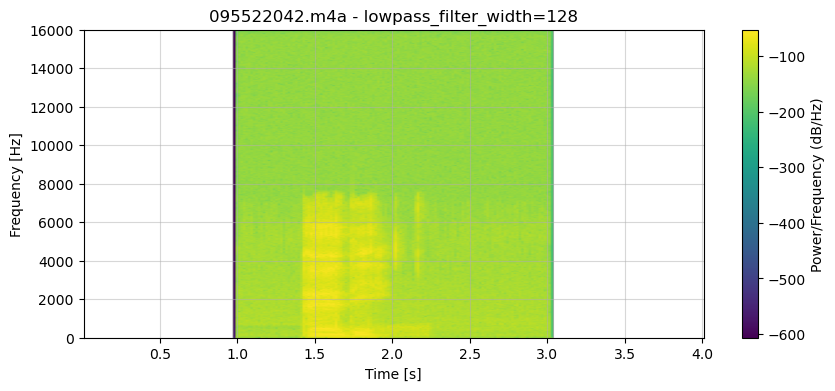

In [8]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with lowpass_filter_width=128
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, lowpass_filter_width=128
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - lowpass_filter_width=128")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\2985979792.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


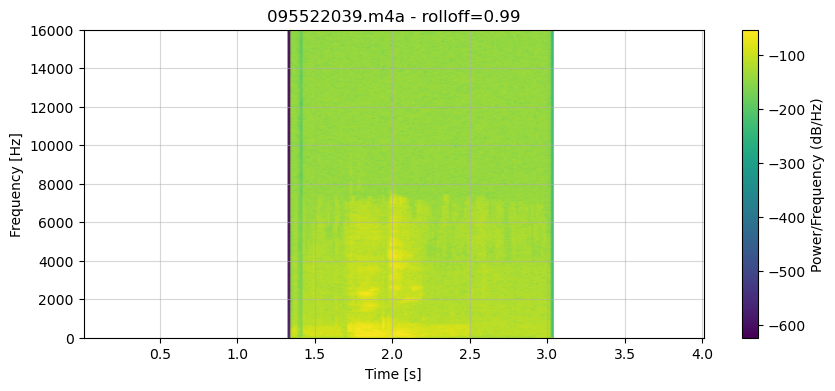


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


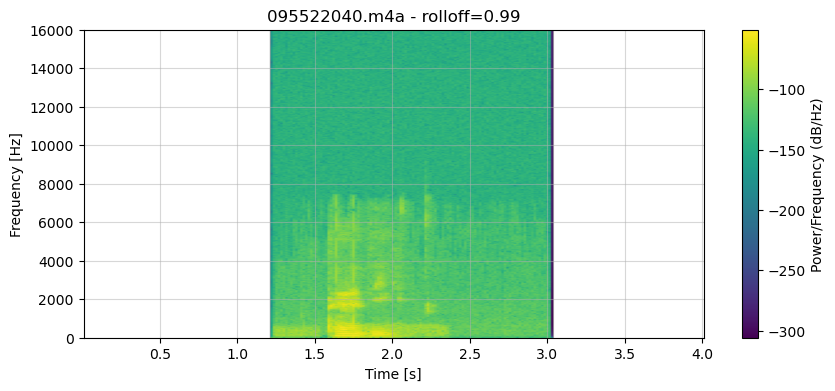


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


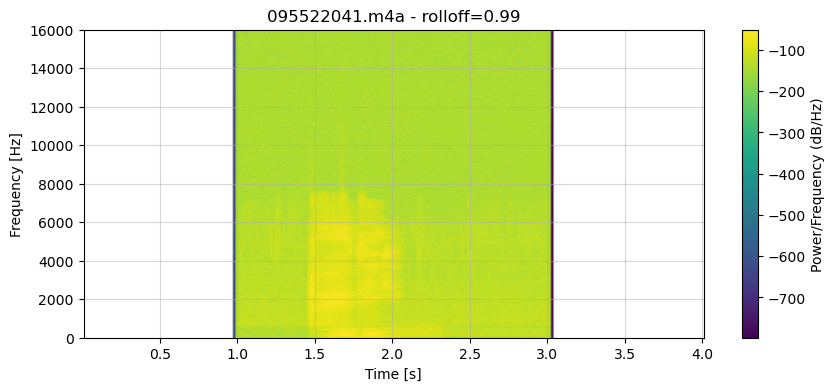


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


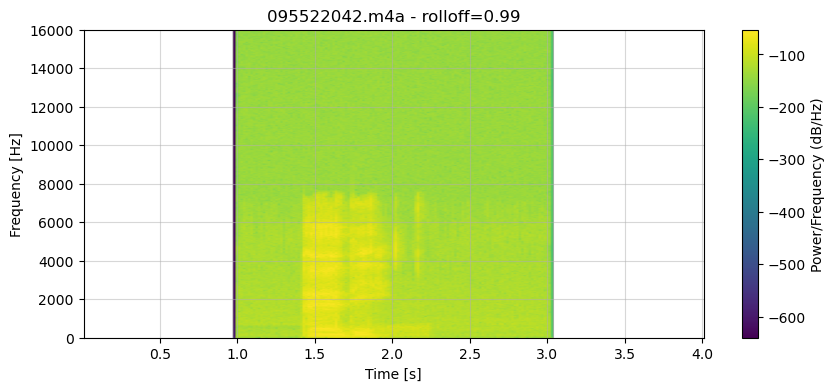

In [9]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with rolloff=0.99
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, rolloff=0.99
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - rolloff=0.99")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\3427803100.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


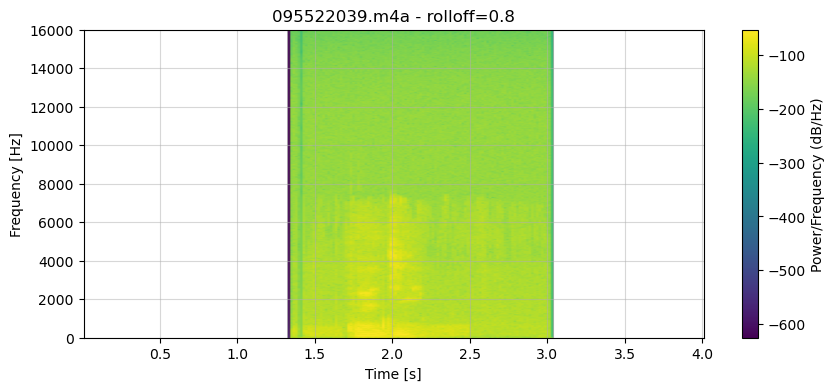


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


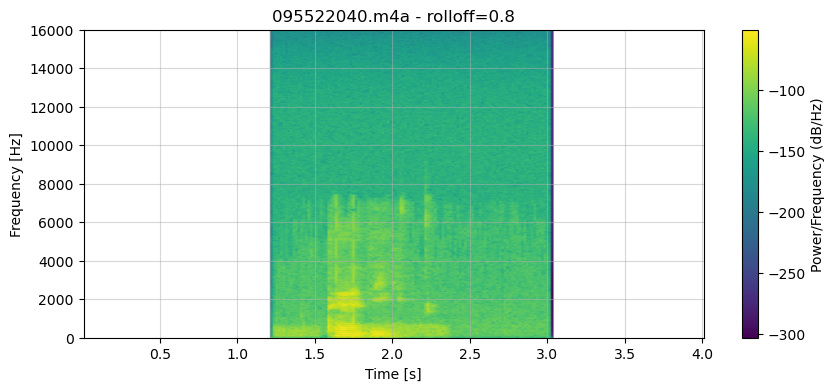


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


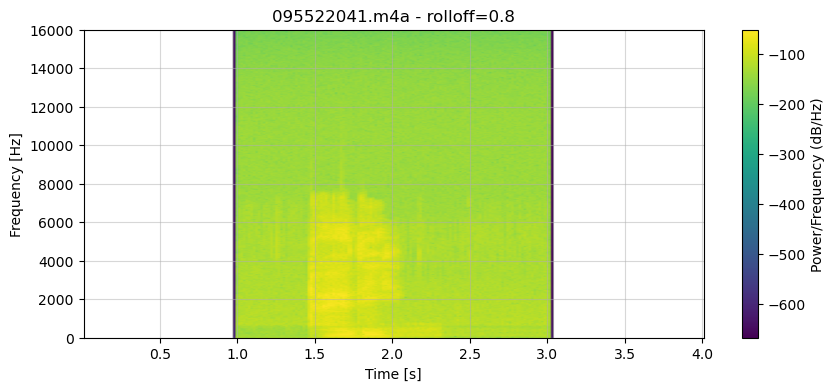


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


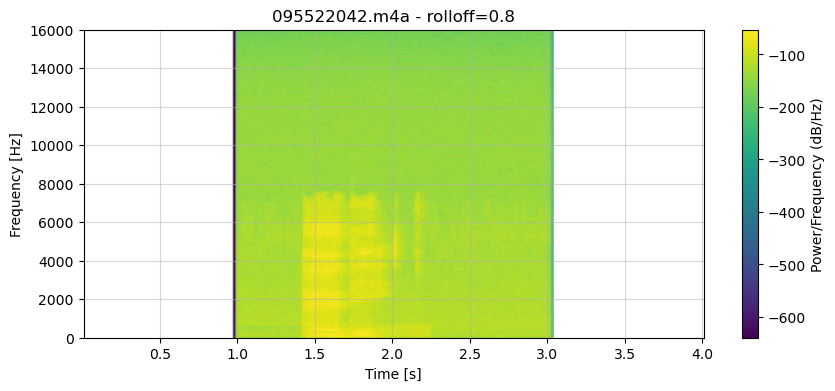

In [10]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with rolloff=0.8
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, rolloff=0.8
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - rolloff=0.8")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\2206250143.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


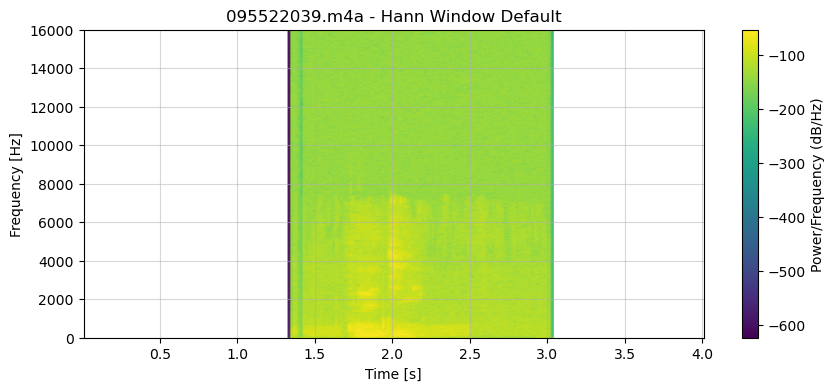


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


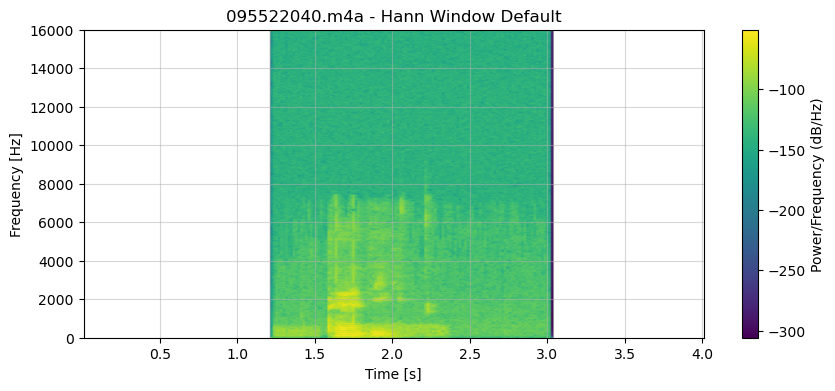


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


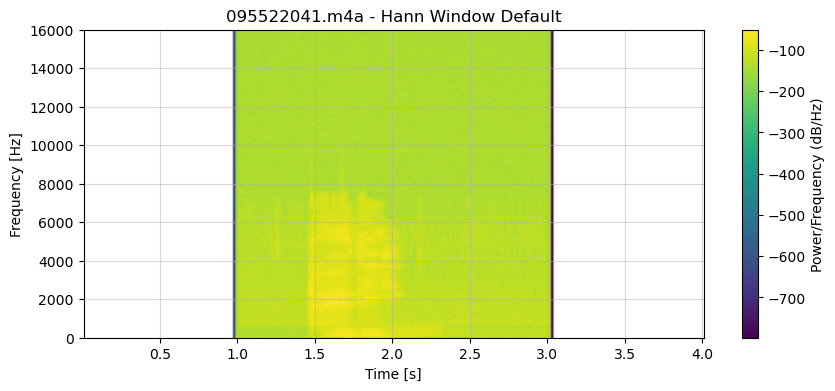


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


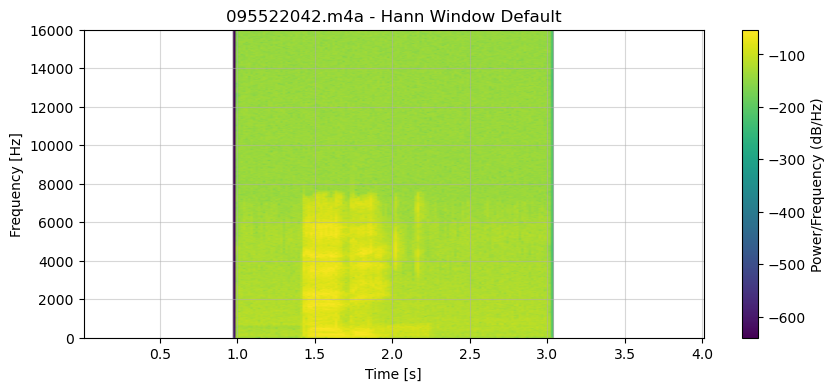

In [11]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with Hann window method
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        resampling_method="sinc_interp_hann"
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Hann Window Default")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\2253354229.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


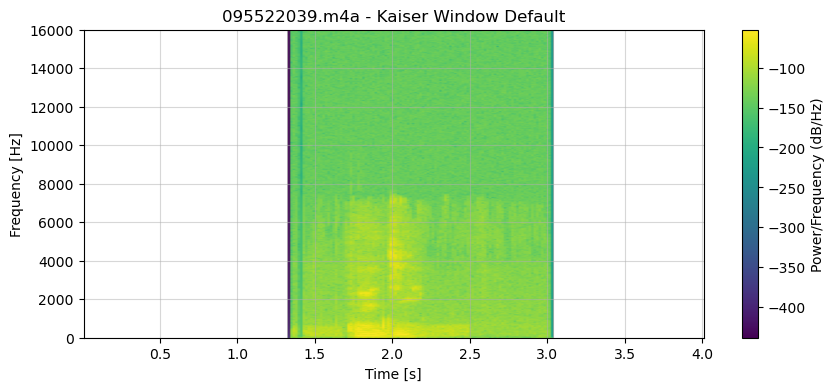


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


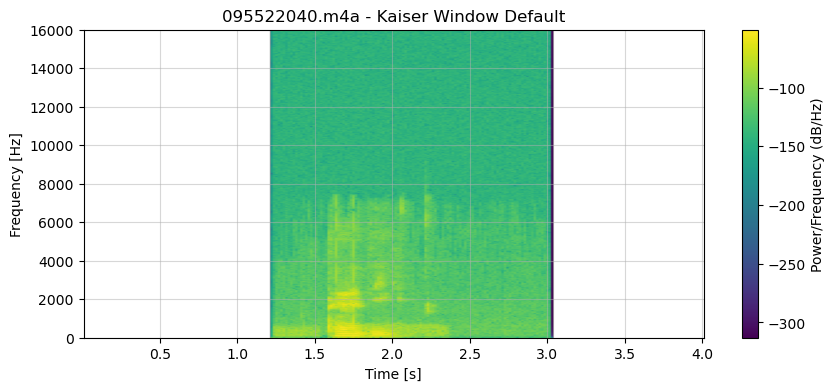


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


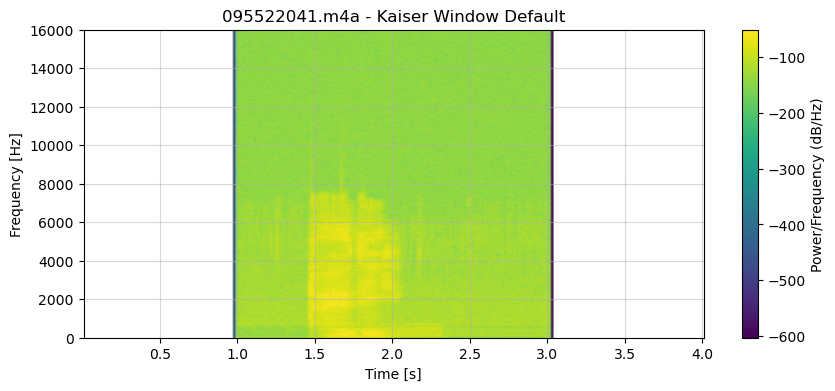


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


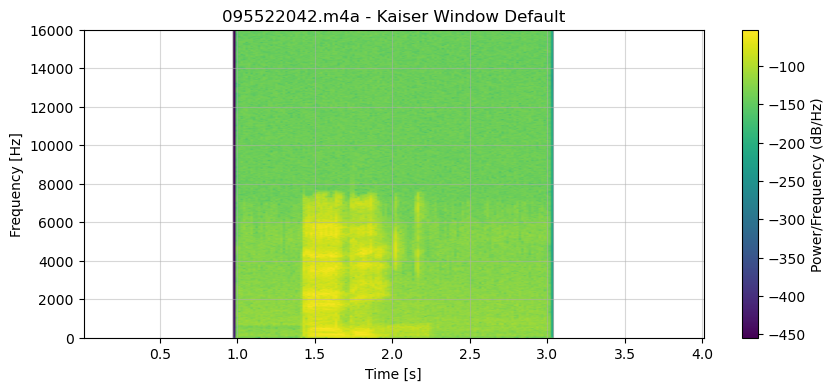

In [12]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with Kaiser window method (default settings)
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        resampling_method="sinc_interp_kaiser"
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Default")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\700466677.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


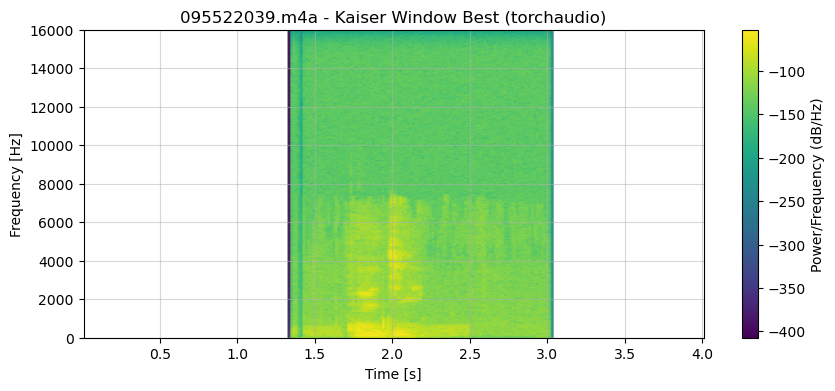


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


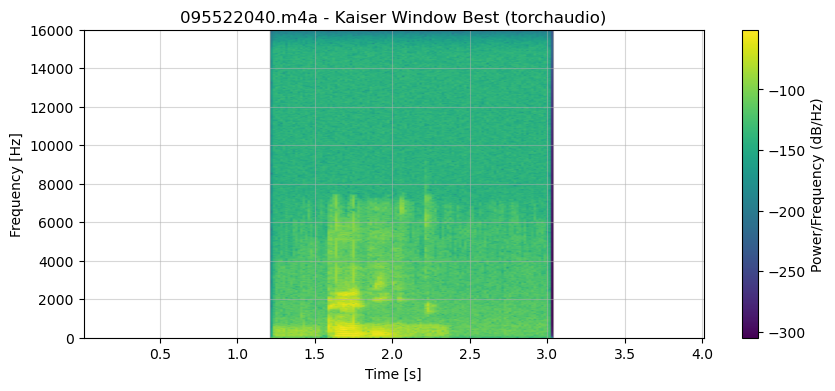


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


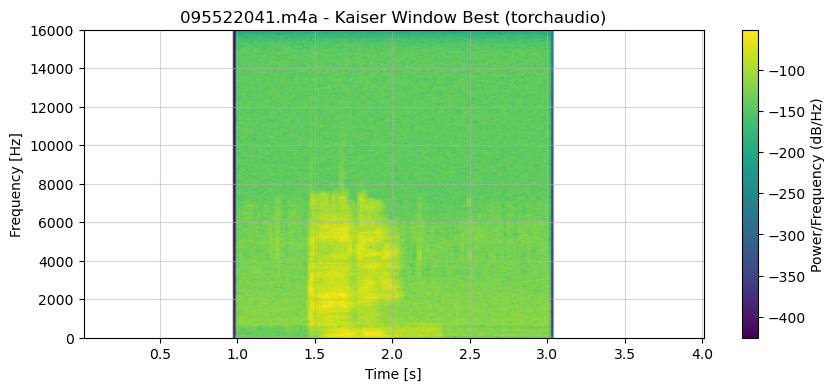


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


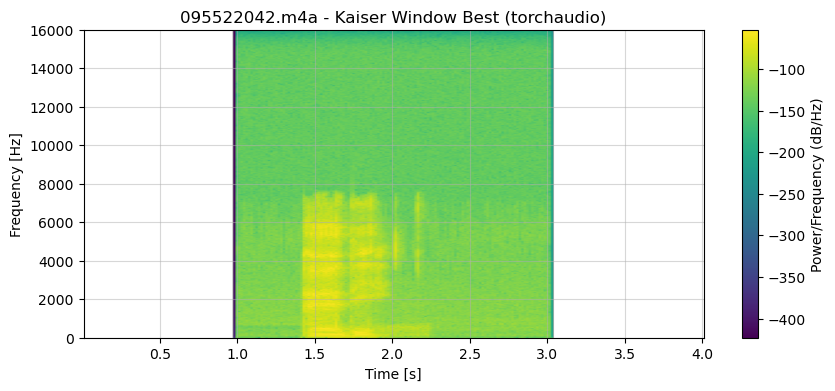

In [13]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with Kaiser Window Best parameters (high quality)
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=64,
        rolloff=0.9475937167399596,
        resampling_method="sinc_interp_kaiser",
        beta=14.769656459379492,
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Best (torchaudio)")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\700466677.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


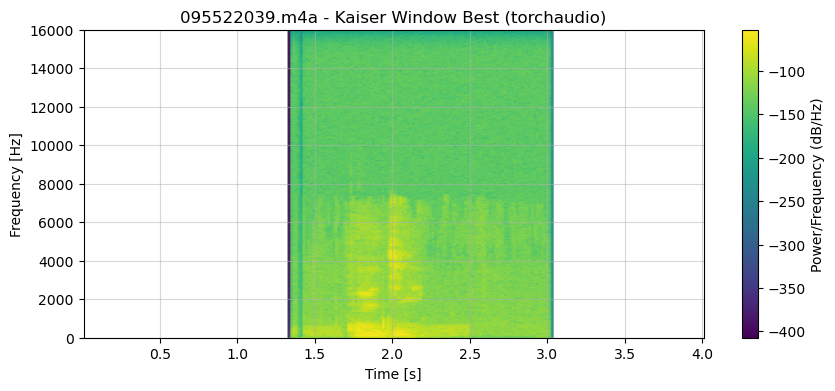


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


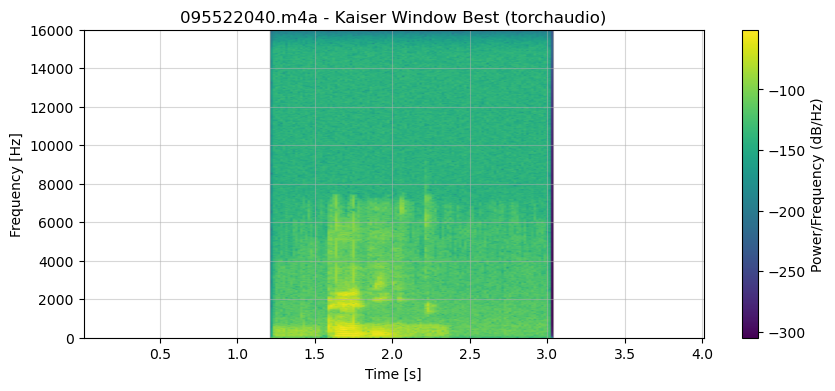


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


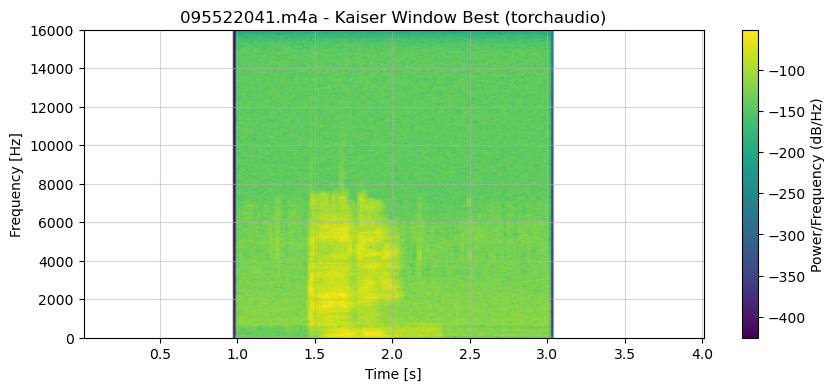


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


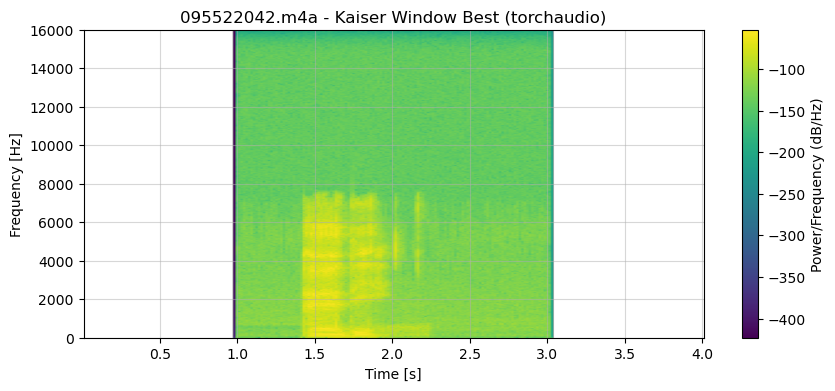

In [14]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with Kaiser Window Best parameters (high quality)
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=64,
        rolloff=0.9475937167399596,
        resampling_method="sinc_interp_kaiser",
        beta=14.769656459379492,
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Best (torchaudio)")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\3390977462.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


c:\Users\user\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


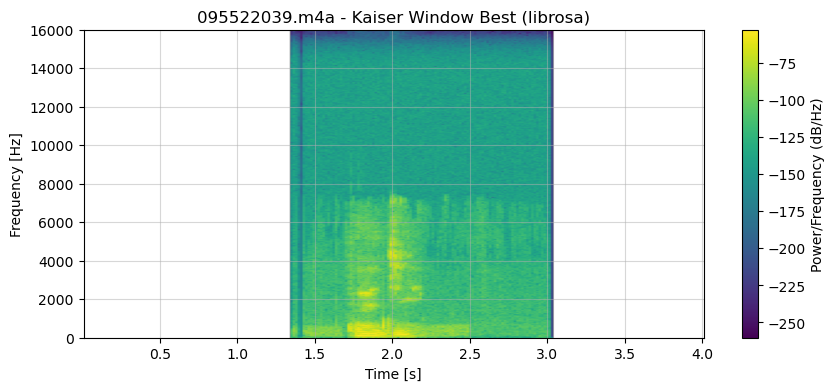

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\3390977462.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


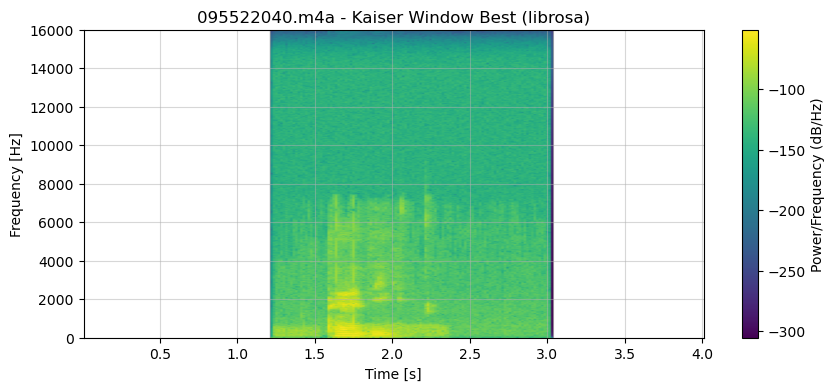


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


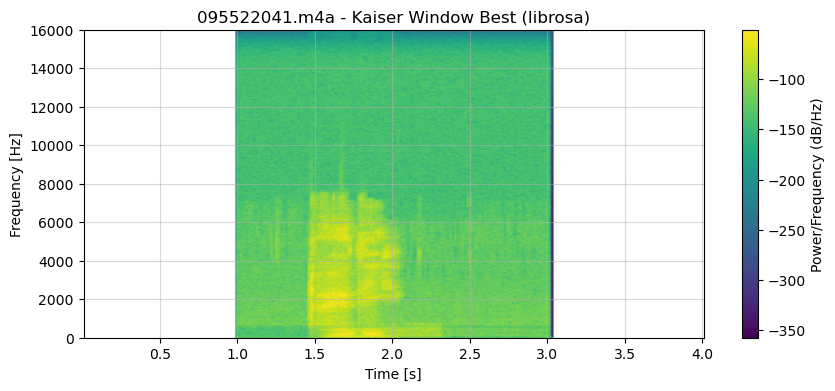


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


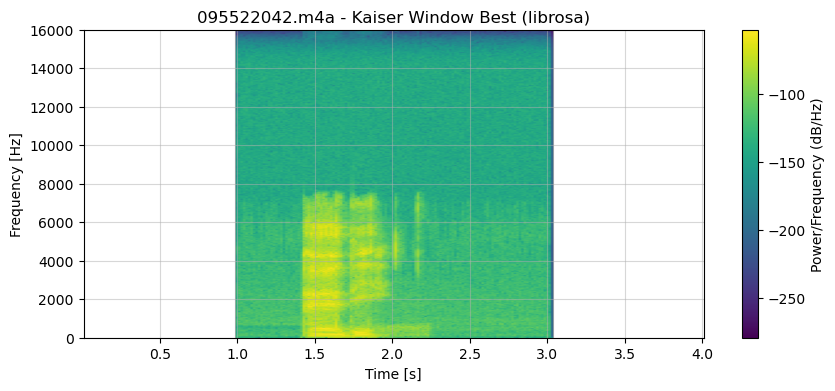

In [15]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with librosa (kaiser_best)
    librosa_resampled_waveform = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_best"
        )
    ).unsqueeze(0)

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of librosa resampled audio
    plot_sweep_real(librosa_resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Best (librosa)")

    # Play audio
    display(Audio(librosa_resampled_waveform.numpy()[0], rate=resample_rate))


In [16]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # torchaudio resample (kaiser_best params)
    torchaudio_resampled = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=64,
        rolloff=0.9475937167399596,
        resampling_method="sinc_interp_kaiser",
        beta=14.769656459379492,
    )

    # librosa resample (kaiser_best)
    librosa_resampled = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_best"
        )
    ).unsqueeze(0)

    # Calculate MSE
    mse = torch.square(torchaudio_resampled - librosa_resampled).mean().item()
    print(f"{f} → torchaudio vs librosa kaiser_best MSE: {mse:.6e}")


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\2501433834.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


095522039.m4a → torchaudio vs librosa kaiser_best MSE: 9.394557e-13
095522040.m4a → torchaudio vs librosa kaiser_best MSE: 1.019389e-12
095522041.m4a → torchaudio vs librosa kaiser_best MSE: 1.210689e-12
095522042.m4a → torchaudio vs librosa kaiser_best MSE: 1.226972e-12


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\1362553110.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


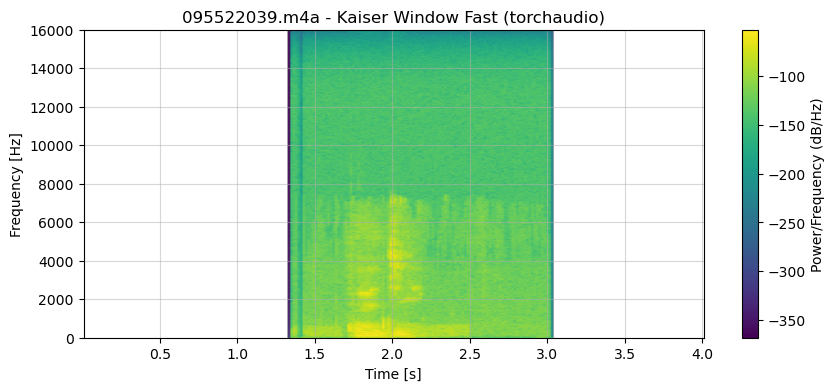


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


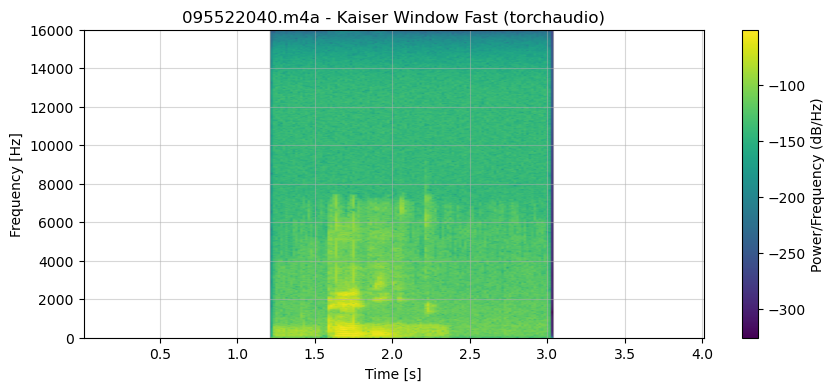


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


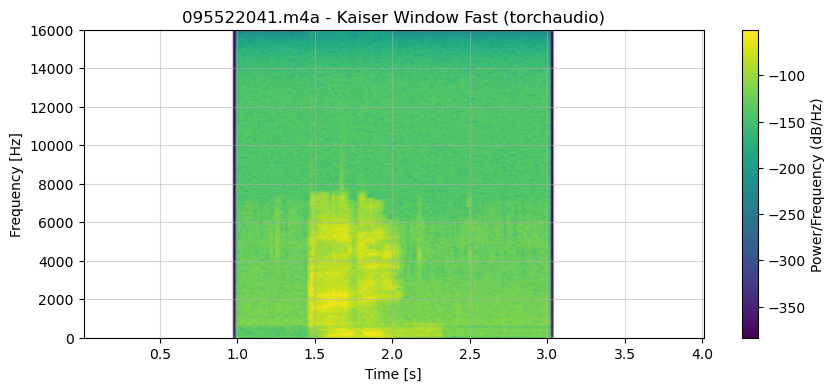


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


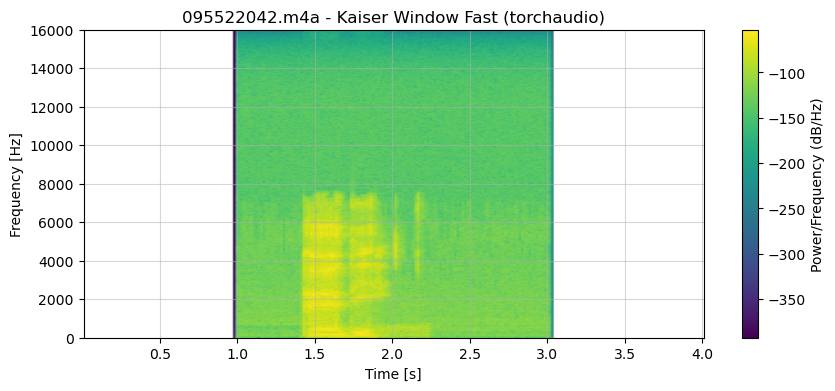

In [17]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with Kaiser Window Fast parameters (faster but lower quality)
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=16,
        rolloff=0.85,
        resampling_method="sinc_interp_kaiser",
        beta=8.555504641634386,
    )

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of resampled audio
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Fast (torchaudio)")

    # Play audio
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\349175916.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a ===
Original SR: 44100, Resampled SR: 32000


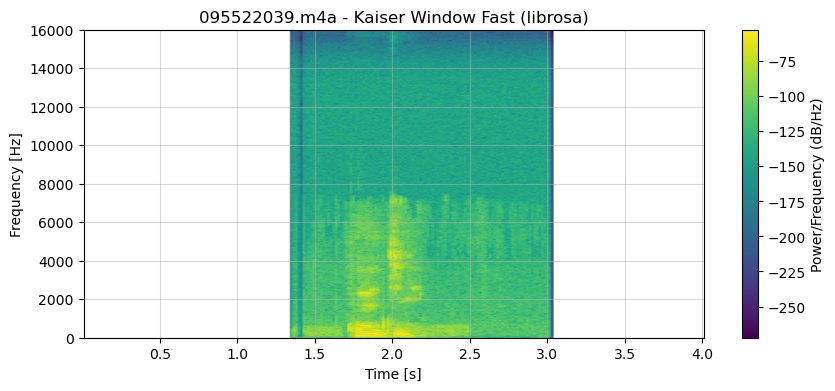


=== 095522040.m4a ===
Original SR: 44100, Resampled SR: 32000


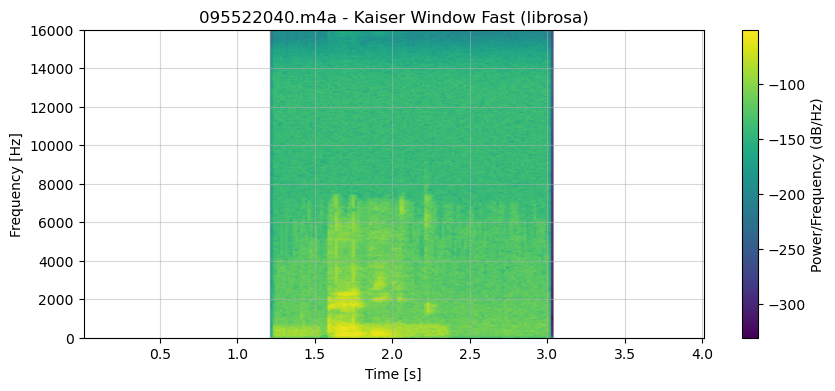


=== 095522041.m4a ===
Original SR: 44100, Resampled SR: 32000


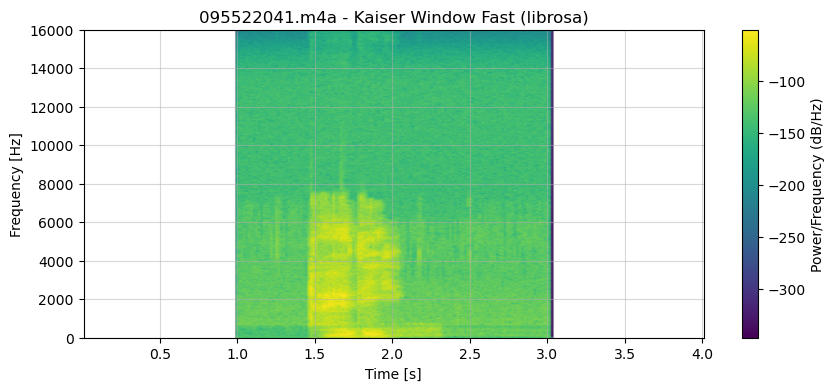


=== 095522042.m4a ===
Original SR: 44100, Resampled SR: 32000


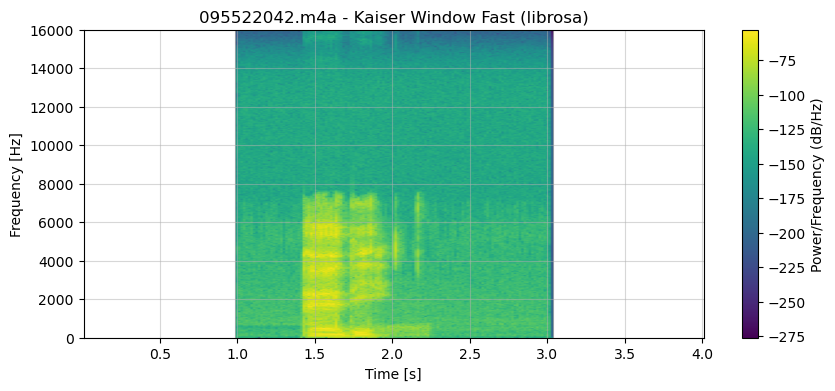

In [18]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # Resample with librosa (kaiser_fast)
    librosa_resampled_waveform = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_fast"
        )
    ).unsqueeze(0)

    print(f"\n=== {f} ===")
    print(f"Original SR: {sample_rate}, Resampled SR: {resample_rate}")

    # Plot spectrogram of librosa resampled audio
    plot_sweep_real(librosa_resampled_waveform, resample_rate,
                    title=f"{f} - Kaiser Window Fast (librosa)")

    # Play audio
    display(Audio(librosa_resampled_waveform.numpy()[0], rate=resample_rate))


In [19]:
resample_rate = 32000  # target sample rate

for f in FILES:  # FILES = ["095522039.m4a", ..., "095522042.m4a"]
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    # torchaudio Kaiser Fast
    torchaudio_resampled = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=16,
        rolloff=0.85,
        resampling_method="sinc_interp_kaiser",
        beta=8.555504641634386,
    )

    # librosa Kaiser Fast
    librosa_resampled = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_fast"
        )
    ).unsqueeze(0)

    # Calculate MSE
    mse = torch.square(torchaudio_resampled - librosa_resampled).mean().item()
    print(f"{f} → torchaudio vs librosa kaiser_fast MSE: {mse:.6e}")


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_24952\1852349188.py:5: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


095522039.m4a → torchaudio vs librosa kaiser_fast MSE: 9.739011e-12
095522040.m4a → torchaudio vs librosa kaiser_fast MSE: 1.226000e-11
095522041.m4a → torchaudio vs librosa kaiser_fast MSE: 2.255223e-11
095522042.m4a → torchaudio vs librosa kaiser_fast MSE: 2.316279e-11


In [20]:
print(f"torchaudio: {torchaudio.__version__}")
print(f"librosa: {librosa.__version__}")
print(f"resampy: {resampy.__version__}")

torchaudio: 2.8.0+cpu
librosa: 0.11.0
resampy: 0.4.3
